# Модуль 1

### 1.1 Парсинг данных

In [2]:
#Импортирование необходимых библиотек
import pandas as pd
import numpy as np
from pprint import pprint
import matplotlib.pyplot as plt
import seaborn as sns

import codecs
import json
import glob
pd.set_option('display.max_columns', None)
from pandas import json_normalize

**Импорт статей**

In [5]:
#Путь к файлам .geojson

path = 'C:/dark/ASAS/AFAF/Data'
file = glob.glob(path + "/*.json")
df_full=pd.DataFrame()

#df_full=pd.DataFrame(columns=['Пост', 'день публикации', 'месяц публикации', 'время публикации'])
#Цикл для получения файла и его загрузки, используя json.load 
for filename in file:
    name = filename.split("\\")[-1][:-5]
    with codecs.open(filename, 'r', 'utf-8-sig') as json_file:  
        data = json.load(json_file)
    
    for article in data['refs']:  
        if article != None:
            df=pd.concat(
                [
                    pd.DataFrame([article[0]],columns=['Post']),
                    json_normalize(article[1]),
                    pd.DataFrame([name],columns=['Company'])
                ],
                axis=1
            )
            df_full=pd.concat([df_full,df],axis=0,ignore_index=True)

In [8]:
df_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1112 entries, 0 to 1111
Data columns (total 5 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   Post     1112 non-null   object
 1   day      1112 non-null   object
 2   month    1112 non-null   object
 3   time     1112 non-null   object
 4   Company  1112 non-null   object
dtypes: object(5)
memory usage: 43.6+ KB


In [9]:
df_full.head()

,Post,day,month,time,Company
0,7 декабря состоялась церемония награждения лау...,8,декабря,09:30,Cybersport.Metaratings
1,7 декабря состоялась церемония награждения лау...,8,декабря,09:30,ESforce Holding
2,Из совместного исследования издателя компьютер...,29,июля,13:50,ESforce Holding
3,По статистике The Esports Observer за I полови...,9,июля,09:33,ESforce Holding
4,Компании SuperData Research и PayPal провели с...,11,апреля,12:43,ESforce Holding


Датафрейм с информацией о компании

In [10]:
#Путь к файлам .geojson
path = 'C:/dark/ASAS/AFAF/Data'
file = glob.glob(path + "/*.json")


df = pd.DataFrame(columns=['rate','subs','industries','about','Company']) 

#Цикл для получения файла и его загрузки, используя json.load 
for filename in file:
    with codecs.open(filename, 'r', 'utf-8-sig') as json_file:  
        data = json.load(json_file)
        name = filename.split("\\")[-1][:-5]   
        try:
            company_info=pd.concat([json_normalize(data['info']),pd.DataFrame([name],columns=['Company'])],axis=1)
        except:
            d={'rate':['Не указано'],'subs':['Не указано'],'industries':['Не указано'],'about':['Не указано']}
            company_info=pd.concat([pd.DataFrame(d),pd.DataFrame([name],columns=['Company'])],axis=1)
    df = pd.concat([df,company_info], axis=0, ignore_index=True)
df.head()

,rate,subs,industries,about,Company
0,Не указано,Не указано,Не указано,Не указано,Cybersport.Metaratings
1,Не указано,Не указано,Не указано,Не указано,ESforce Holding
2,Не указано,Не указано,Не указано,Не указано,Gett
3,Не указано,Не указано,Не указано,Не указано,Goose Gaming
4,Не указано,Не указано,Не указано,Не указано,MMA.Metaratings


In [11]:
tk = df_full.merge(df, on='Company',how='left')

In [12]:
tk.shape

(1112, 9)

In [13]:
tk.head(200)

,Post,day,month,time,Company,rate,subs,industries,about
0,7 декабря состоялась церемония награждения лау...,8,декабря,09:30,Cybersport.Metaratings,Не указано,Не указано,Не указано,Не указано
1,7 декабря состоялась церемония награждения лау...,8,декабря,09:30,ESforce Holding,Не указано,Не указано,Не указано,Не указано
2,Из совместного исследования издателя компьютер...,29,июля,13:50,ESforce Holding,Не указано,Не указано,Не указано,Не указано
3,По статистике The Esports Observer за I полови...,9,июля,09:33,ESforce Holding,Не указано,Не указано,Не указано,Не указано
4,Компании SuperData Research и PayPal провели с...,11,апреля,12:43,ESforce Holding,Не указано,Не указано,Не указано,Не указано
...,...,...,...,...,...,...,...,...,...
195,"Владимир Матасов, выпускник курса Skillbox по ...",14,октября,11:47,skillbox,113.82,71000,"[Веб-разработка, Дизайн и юзабилити, Реклама и...",Образовательная платформа Skillbox — один из л...
196,С какого возраста можно обучать ребенка програ...,13,октября,16:58,skillbox,113.82,71000,"[Веб-разработка, Дизайн и юзабилити, Реклама и...",Образовательная платформа Skillbox — один из л...
197,"Глава Mail.Ru Group Борис Добродеев объявил, ч...",12,октября,11:22,skillbox,113.82,71000,"[Веб-разработка, Дизайн и юзабилити, Реклама и...",Образовательная платформа Skillbox — один из л...
198,Mail.ru Group сообщила об объединении образова...,5,октября,14:15,skillbox,113.82,71000,"[Веб-разработка, Дизайн и юзабилити, Реклама и...",Образовательная платформа Skillbox — один из л...


**Вывод** 

Построен исходный набор данных, в набор включены все необходимые данные. 
Набор был преобразован в требуемый формат. Добавление дополнительных атрибутов не требуется.

### 1.2 Формирование структуры набора данных

Написать письменно здесь все

### 1.3 Предварительная обработка данных  

In [15]:
import pymorphy2
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

In [16]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Даня\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\stopwords.zip.


True

In [17]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Даня\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping tokenizers\punkt.zip.


True

In [18]:
sw = stopwords.words('russian')
morph = pymorphy2.MorphAnalyzer()

def clear_text(text):
    text=text.lower()
    text = re.sub(r'[^а-яё ]','', str(text))
    tokens=word_tokenize(text, language="russian")
    tokens = [morph.parse(i)[0].normal_form for i in tokens]
    tokens = [i for i in tokens if i not in sw and len(i) > 3]
    return tokens

In [19]:
tk['lemmatize_tokens'] = tk['Post'].apply(clear_text)

In [20]:
tk.head()

,Post,day,month,time,Company,rate,subs,industries,about,lemmatize_tokens
0,7 декабря состоялась церемония награждения лау...,8,декабря,09:30,Cybersport.Metaratings,Не указано,Не указано,Не указано,Не указано,"[декабрь, состояться, церемония, награждение, ..."
1,7 декабря состоялась церемония награждения лау...,8,декабря,09:30,ESforce Holding,Не указано,Не указано,Не указано,Не указано,"[декабрь, состояться, церемония, награждение, ..."
2,Из совместного исследования издателя компьютер...,29,июля,13:50,ESforce Holding,Не указано,Не указано,Не указано,Не указано,"[совместный, исследование, издатель, компьютер..."
3,По статистике The Esports Observer за I полови...,9,июля,09:33,ESforce Holding,Не указано,Не указано,Не указано,Не указано,"[статистика, половина, впервые, самый, просмат..."
4,Компании SuperData Research и PayPal провели с...,11,апреля,12:43,ESforce Holding,Не указано,Не указано,Не указано,Не указано,"[компания, провести, совместный, исследование,..."


In [21]:
tk['clear_text'] = tk['lemmatize_tokens'].apply(lambda x: " ".join(x))

In [22]:
tk.head()

,Post,day,month,time,Company,rate,subs,industries,about,lemmatize_tokens,clear_text
0,7 декабря состоялась церемония награждения лау...,8,декабря,09:30,Cybersport.Metaratings,Не указано,Не указано,Не указано,Не указано,"[декабрь, состояться, церемония, награждение, ...",декабрь состояться церемония награждение лауре...
1,7 декабря состоялась церемония награждения лау...,8,декабря,09:30,ESforce Holding,Не указано,Не указано,Не указано,Не указано,"[декабрь, состояться, церемония, награждение, ...",декабрь состояться церемония награждение лауре...
2,Из совместного исследования издателя компьютер...,29,июля,13:50,ESforce Holding,Не указано,Не указано,Не указано,Не указано,"[совместный, исследование, издатель, компьютер...",совместный исследование издатель компьютерный ...
3,По статистике The Esports Observer за I полови...,9,июля,09:33,ESforce Holding,Не указано,Не указано,Не указано,Не указано,"[статистика, половина, впервые, самый, просмат...",статистика половина впервые самый просматриват...
4,Компании SuperData Research и PayPal провели с...,11,апреля,12:43,ESforce Holding,Не указано,Не указано,Не указано,Не указано,"[компания, провести, совместный, исследование,...",компания провести совместный исследование евро...


In [23]:
tk.to_csv('data.csv', index=False, encoding='utf-8-sig')

In [24]:
tk.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1112 entries, 0 to 1111
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Post              1112 non-null   object
 1   day               1112 non-null   object
 2   month             1112 non-null   object
 3   time              1112 non-null   object
 4   Company           1112 non-null   object
 5   rate              1112 non-null   object
 6   subs              1112 non-null   object
 7   industries        1112 non-null   object
 8   about             1112 non-null   object
 9   lemmatize_tokens  1112 non-null   object
 10  clear_text        1112 non-null   object
dtypes: object(11)
memory usage: 104.2+ KB


Вывод:
В качестве оптимапльной предварительной обработтки данных был выбран метод лемматизации, поскольку данный метод приводит слова в начальную форму, что значительно упрощает дальнейшую работу с данными. 

Были удалены стоп-слова и лишние символы. Пропущенные данные отсутствуют, вследсвие чего обработка пропущенных значений не требуется

# 1.4 Векторизация текста и поиск ngram

In [25]:
import sklearn
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer, HashingVectorizer

**Первый способ векторизации**

In [26]:
tfidf = TfidfVectorizer(min_df=5,max_df=0.8, ngram_range=(1, 2))
X_tfidf = tfidf.fit_transform(tk['clear_text'])

df_tfidf = pd.DataFrame(X_tfidf.toarray(), columns = tfidf.get_feature_names_out())
df_tfidf.head()

,аббревиатура,абзац,абитуриент,абонент,абсолютно,абсолютно весь,абсолютно любой,абсолютно новый,абсолютно нормально,абсолютно разный,абсолютно уверенный,абсолютный,абсолютный большинство,абстрагирование,абстрагироваться,абстрактный,абстракция,абсурдный,аванс,авантюра,аварийный,авария,аватар,август,авиабилет,авиакомпания,авиационный,авиация,авить,авот,австралийский,австралия,австрия,авто,автобус,автобусный,автограф,автодополнение,автомат,автоматизатор,автоматизация,автоматизация бизнес,автоматизация процесс,автоматизация работа,автоматизация тестирование,автоматизированный,автоматизированный система,автоматизированный тестирование,автоматизировать,автоматизировать процесс,автоматизировать рутинный,автоматика,автоматически,автоматический,автоматический режим,автоматический система,автоматический тестирование,автомобилист,автомобиль,автомобильный,автономно,автономность,автономный,автономный некоммерческий,автономный работа,автопарк,автопилот,автор,автор давать,автор идея,автор книга,автор который,автор курс,автор мочь,автор получить,автор помочь,автор предоставить,автор проект,автор рассказывать,автор свой,автор статья,автор телеграмканал,автор хороший,автор чтоть,авторизация,авторизовать,авторитет,авторитетный,авторский,авторский канал,авторский право,авторство,автотест,агенство,агент,агентский,агентство,агентство который,агентство специализироваться,агентство студия,агентство тасс,агентство туризм,агрегат,агрегатор,агрегатор такси,агрегация,агрегировать,агрессивно,агрессивный,агрессия,адам,адаптация,адаптер,адаптивность,адаптивный,адаптивный вёрстка,адаптивный дизайн,адаптировать,адаптировать свой,адаптироваться,адвокат,адекватно,адекватность,адекватный,адекватный цена,адекватный человек,адепт,админ,административный,администратор,администратор который,администрация,администрация президент,администрирование,админк,админовый,адольф,адреналин,адрес,адрес который,адрес электронный,адресат,адресный,адресовать,адский,аести,аещё,ажиотаж,азарт,азартный,азартный игра,азбука,азиатский,азия,азов,азотный,айдентик,айсберг,айти,айти курс,айтишник,айтишный,айфон,академик,академический,академия,академия наука,аквариум,аккаунт,аккорд,аккредитация,аккумулятор,аккумуляторный,аккуратно,аккуратность,аккуратный,акселератор,аксессуар,актив,активация,активизировать,активизироваться,активировать,активироваться,активист,активно,активно заниматься,активно искать,активно использовать,активно использоваться,активно общаться,активно пользоваться,активно продвигать,активно работать,активно развиваться,активно расти,активно участвовать,активность,активность который,активность мозг,активный,активный использование,активный пользователь,активный работа,активный сообщество,активный участие,активный участник,актриса,актуализация,актуализировать,актуально,актуальность,актуальный,актуальный версия,актуальный вопрос,актуальный информация,актуальный проблема,актуальный состояние,актуальный тема,актёр,акустический,акцент,акцентировать,акцентировать внимание,акционер,акция,акция компания,алан,алгоритм,алгоритм который,алгоритм машинный,алгоритм мочь,алгоритм обработка,алгоритм очень,алгоритм поиск,алгоритм работа,алгоритм распознавание,алгоритм структура,алгоритмика,алгоритмический,алекс,александр,александр рассказать,александрович,алексей,алексей копылов,алексей некрасов,алерот,алиас,алина,алиса,алиэкспресс,алкоголизм,алкоголь,алкогольный,аллергия,алло,алфавит,алфавитный,алфавитный порядок,альберт,альбом,альтернатива,альтернативный,альтернативный вариант,альтернативный метод,альф,альфа,альфабанк,альфабанка,альцгеймер,алюминиевый,алюминий,алёна,амазона,амбициозный,амбициозный цель,амбиция,америка,американец,американский,американский компания,амортизатор,амочь,ампер,амплитуда,амстердам,амстердам нидерланды,анализ,анализ данные,анализ который,анализ кровь,анализ медицинский,анализ работа,анализ рынок,анализатор,анализировать,анализировать дать,анализироваться,аналитик,аналитик бывать,аналитик данные,аналитик который,аналитик тестировщик,аналитика,аналитика данные,аналитич

In [27]:
X_tfidf

<1112x31220 sparse matrix of type '<class 'numpy.float64'>'
	with 714739 stored elements in Compressed Sparse Row format>

In [28]:
df_tfidf["Company"]=tk["Company"]

**Второй способ векторизации**

In [29]:
count = CountVectorizer(min_df=5,max_df=0.8, ngram_range=(1, 2))
X_count = count.fit_transform(tk['clear_text'])
df_count = pd.DataFrame(X_count.toarray(),columns = count.get_feature_names_out())
df_count.head()

,аббревиатура,абзац,абитуриент,абонент,абсолютно,абсолютно весь,абсолютно любой,абсолютно новый,абсолютно нормально,абсолютно разный,абсолютно уверенный,абсолютный,абсолютный большинство,абстрагирование,абстрагироваться,абстрактный,абстракция,абсурдный,аванс,авантюра,аварийный,авария,аватар,август,авиабилет,авиакомпания,авиационный,авиация,авить,авот,австралийский,австралия,австрия,авто,автобус,автобусный,автограф,автодополнение,автомат,автоматизатор,автоматизация,автоматизация бизнес,автоматизация процесс,автоматизация работа,автоматизация тестирование,автоматизированный,автоматизированный система,автоматизированный тестирование,автоматизировать,автоматизировать процесс,автоматизировать рутинный,автоматика,автоматически,автоматический,автоматический режим,автоматический система,автоматический тестирование,автомобилист,автомобиль,автомобильный,автономно,автономность,автономный,автономный некоммерческий,автономный работа,автопарк,автопилот,автор,автор давать,автор идея,автор книга,автор который,автор курс,автор мочь,автор получить,автор помочь,автор предоставить,автор проект,автор рассказывать,автор свой,автор статья,автор телеграмканал,автор хороший,автор чтоть,авторизация,авторизовать,авторитет,авторитетный,авторский,авторский канал,авторский право,авторство,автотест,агенство,агент,агентский,агентство,агентство который,агентство специализироваться,агентство студия,агентство тасс,агентство туризм,агрегат,агрегатор,агрегатор такси,агрегация,агрегировать,агрессивно,агрессивный,агрессия,адам,адаптация,адаптер,адаптивность,адаптивный,адаптивный вёрстка,адаптивный дизайн,адаптировать,адаптировать свой,адаптироваться,адвокат,адекватно,адекватность,адекватный,адекватный цена,адекватный человек,адепт,админ,административный,администратор,администратор который,администрация,администрация президент,администрирование,админк,админовый,адольф,адреналин,адрес,адрес который,адрес электронный,адресат,адресный,адресовать,адский,аести,аещё,ажиотаж,азарт,азартный,азартный игра,азбука,азиатский,азия,азов,азотный,айдентик,айсберг,айти,айти курс,айтишник,айтишный,айфон,академик,академический,академия,академия наука,аквариум,аккаунт,аккорд,аккредитация,аккумулятор,аккумуляторный,аккуратно,аккуратность,аккуратный,акселератор,аксессуар,актив,активация,активизировать,активизироваться,активировать,активироваться,активист,активно,активно заниматься,активно искать,активно использовать,активно использоваться,активно общаться,активно пользоваться,активно продвигать,активно работать,активно развиваться,активно расти,активно участвовать,активность,активность который,активность мозг,активный,активный использование,активный пользователь,активный работа,активный сообщество,активный участие,активный участник,актриса,актуализация,актуализировать,актуально,актуальность,актуальный,актуальный версия,актуальный вопрос,актуальный информация,актуальный проблема,актуальный состояние,актуальный тема,актёр,акустический,акцент,акцентировать,акцентировать внимание,акционер,акция,акция компания,алан,алгоритм,алгоритм который,алгоритм машинный,алгоритм мочь,алгоритм обработка,алгоритм очень,алгоритм поиск,алгоритм работа,алгоритм распознавание,алгоритм структура,алгоритмика,алгоритмический,алекс,александр,александр рассказать,александрович,алексей,алексей копылов,алексей некрасов,алерот,алиас,алина,алиса,алиэкспресс,алкоголизм,алкоголь,алкогольный,аллергия,алло,алфавит,алфавитный,алфавитный порядок,альберт,альбом,альтернатива,альтернативный,альтернативный вариант,альтернативный метод,альф,альфа,альфабанк,альфабанка,альцгеймер,алюминиевый,алюминий,алёна,амазона,амбициозный,амбициозный цель,амбиция,америка,американец,американский,американский компания,амортизатор,амочь,ампер,амплитуда,амстердам,амстердам нидерланды,анализ,анализ данные,анализ который,анализ кровь,анализ медицинский,анализ работа,анализ рынок,анализатор,анализировать,анализировать дать,анализироваться,аналитик,аналитик бывать,аналитик данные,аналитик который,аналитик тестировщик,аналитика,аналитика данные,аналитич

In [30]:
X_count

<1112x31220 sparse matrix of type '<class 'numpy.int64'>'
	with 714739 stored elements in Compressed Sparse Row format>

In [31]:
df_count["Company"]=tk["Company"]

Обоснование выбора алгоритма.

TF-IDF (Term Frequency-Inverse Document Frequency): TF-IDF вычисляет важность терминов в документе, основываясь на их частоте в документе и обратной частоте встречаемости термина в корпусе документов. Этот подход позволяет выделить ключевые слова, которые встречаются часто в конкретных документах, но редко в остальных документах. Вы можете использовать класс TfidfVectorizer из библиотеки scikit-learn для выполнения векторизации и получения TF-IDF-признаков.

CountVectorizer: CountVectorizer преобразует текстовые данные в матрицу счетчиков терминов (частота встречаемости каждого термина). Этот метод может использоваться для извлечения биграмм и триграмм (последовательности из двух и трех слов). Вы можете использовать класс CountVectorizer из библиотеки scikit-learn и установить параметр ngram_range для определения размерности биграмм и триграмм.

### 1.6 Кластеризация

In [39]:
from sklearn.cluster import KMeans, Birch, MiniBatchKMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
from sklearn.mixture import GaussianMixture

In [40]:
X = df_tfidf.drop(["Company"], axis=1)

In [41]:
#обьявляю MinMaxScaler
scaler = MinMaxScaler()
#преобразую данные
X = scaler.fit_transform(X)

In [42]:
#Обьявляю метод главных компонент
pca = PCA(n_components=2)
#Применяю его на данных
X = pca.fit_transform(X)

In [43]:
#Функция для визуализации распределения 
def viz(prediction):
    #Размер фигуры
    plt.figure(figsize=(12, 12))
    plt.subplot(224)
    #Выводить изображение буду при помощи scatter
    plt.scatter(X[:, 0], X[:, 1], c=prediction)
    plt.title("Unevenly Sized Blobs")
    #Вывод изображения
    plt.show()

C:\dark\ASAS\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\dark\ASAS\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


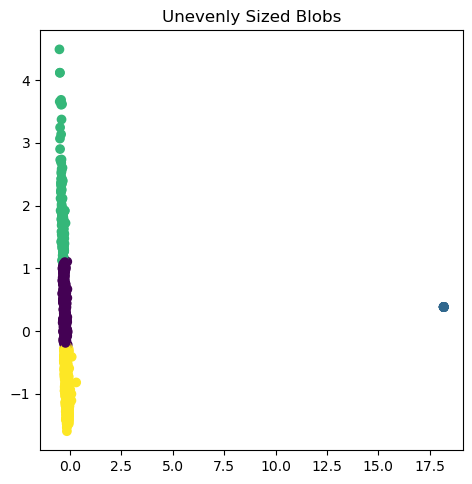

In [44]:
#Настройка параметров
kmeans = KMeans(n_clusters=4, random_state=0).fit(X)
#Предсказание
kmpreds = kmeans.predict(X)
#Заношу кластеризированные метки в набор данных
df_tfidf["KMCLUSTS"] = kmpreds

#Применяю функцию описаную выше
viz(df_tfidf["KMCLUSTS"])

C:\dark\ASAS\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\dark\ASAS\lib\site-packages\sklearn\cluster\_kmeans.py:1902: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 3072 or by setting the environment variable OMP_NUM_THREADS=5
  warnings.warn(


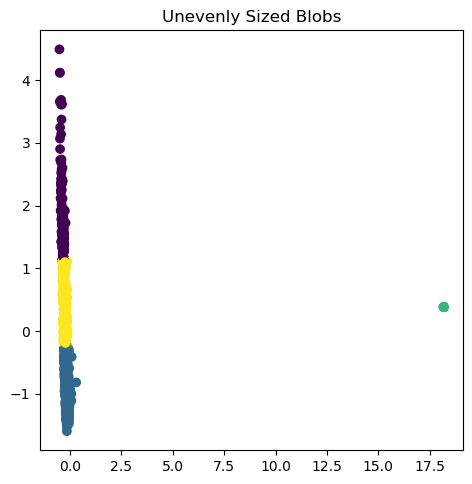

In [45]:
#Настройка параметров
kbmeans = MiniBatchKMeans(n_clusters=4, random_state=0, batch_size=4096)
#Заношу кластеризированные метки в набор данных
df_tfidf["KBCLUSTS"] = kbmeans.fit_predict(X)

viz(df_tfidf["KBCLUSTS"])

C:\dark\ASAS\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


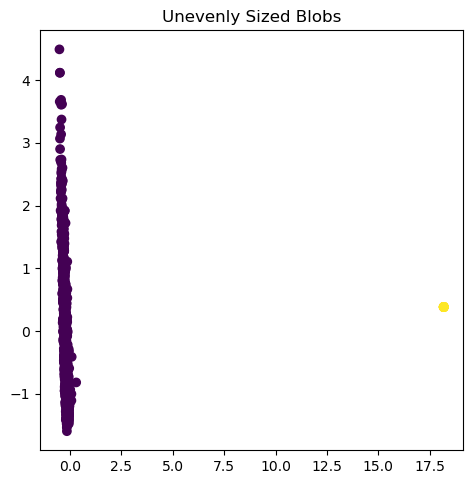

In [46]:
#Настройка параметров
gm = GaussianMixture(n_components=2, random_state=0).fit_predict(X)
#Заношу кластеризированные метки в набор данных
df_tfidf["GMCLUSTS"] = gm

viz(df_tfidf["GMCLUSTS"])

Обоснуйте выбор методов и приемов

K-means: K-means является одним из самых популярных методов кластеризации. Он пытается разделить данные на заранее заданное количество кластеров, минимизируя сумму квадратов расстояний между точками и их центроидами. Для выбора оптимального количества кластеров можно использовать метод локтя или индекс силуэта.

1.7 Подготовка отчета
Подготовьте отчет о проделанной работе по итогам сессии, в котором будут представлены результаты, выводы и обоснования выбора по каждому разделу задания. Результаты работы должны состоять из отчетов в формате .html и исходников с возможностью перекомпиляции. Архив Data.zip должен содержать все результаты выполнения модуля, а также все необходимые файлы для запуска и проверки участков кода. В файле Readme.txt необходимо описать содержимое результирующих файлов архива Data.zip.

### 2.2 Классификация

In [125]:
df=pd.read_json("C:/dark/ASAS/AFAF/Target.json")
df = df.rename(columns = {"Сompany": "Company"})
df.head()

,Company,Nominations
0,Здоровье.ру,Здоровье и медицина
1,Проект по использованию технологий компьютерно...,Здоровье и медицина
2,Skillbox,"Наука, технологии и инновации"
3,Gett,"Наука, технологии и инновации"
4,Промобот,"Наука, технологии и инновации"


In [126]:
df_tfidf["Company"]

0              Cybersport.Metaratings
1                     ESforce Holding
2                     ESforce Holding
3                     ESforce Holding
4                     ESforce Holding
                    ...              
808    Федерация креативных индустрий
809    Федерация креативных индустрий
810    Федерация креативных индустрий
811    Федерация креативных индустрий
812    Федерация креативных индустрий
Name: Company, Length: 813, dtype: object

In [128]:
df_tfidf=df_tfidf.merge(df, on='Company')
df_tfidf['Nominations']

0      Игровая индустрия и киберспорт
1      Игровая индустрия и киберспорт
2      Игровая индустрия и киберспорт
3      Игровая индустрия и киберспорт
4      Игровая индустрия и киберспорт
                    ...              
808              Креативные индустрии
809              Креативные индустрии
810              Креативные индустрии
811              Креативные индустрии
812              Креативные индустрии
Name: Nominations, Length: 813, dtype: object

<Axes: xlabel='Nominations', ylabel='Count'>

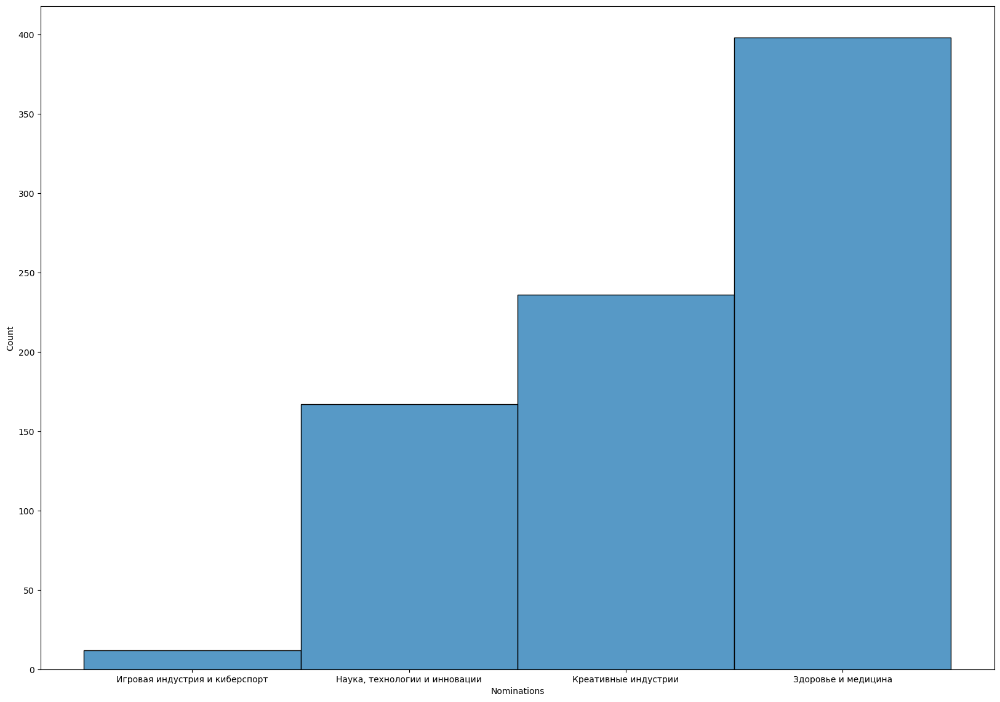

In [129]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(20,14))
sns.histplot(data=df_tfidf,x='Nominations')

In [130]:
from sklearn.model_selection import train_test_split

In [131]:
x=df_tfidf.drop(['Nominations', "Company"], axis=1)
y=df_tfidf['Nominations']

In [132]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=42, stratify=y)

In [133]:
from sklearn.tree import DecisionTreeClassifier as Tree


In [134]:
tree = Tree(max_depth=20, min_samples_split=4, min_samples_leaf=2)

In [137]:
# Выбираем все столбцы, содержащие строки
string_columns = x_train.select_dtypes(include='object').columns

# Применяем One-Hot Encoding ко всем строковым столбцам
x_train = pd.get_dummies(x_train, columns=string_columns)




In [138]:
tree.fit(x_train, y_train)

DecisionTreeClassifier(max_depth=20, min_samples_leaf=2, min_samples_split=4)

# Оценка модели

In [177]:
from sklearn.feature_selection import SelectFromModel
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report
from sklearn.model_selection import learning_curve
import numpy as np

In [178]:
# Разделение данных на обучающий и тестовый наборы
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=42, stratify=y)


In [179]:
# Выбор значимых признаков
sel = SelectFromModel(Tree(max_depth=20, min_samples_split=4, min_samples_leaf=2))
sel.fit(x_train, y_train)


SelectFromModel(estimator=DecisionTreeClassifier(max_depth=20,
                                                 min_samples_leaf=2,
                                                 min_samples_split=4))

In [180]:
# Понижение размерности
x_train_selected = sel.transform(x_train)
x_test_selected = sel.transform(x_test)

In [181]:
# Настройка гиперпараметров
param_grid = {'max_depth': [10, 20, 30, 40],
              'min_samples_split': [2, 4, 6, 8],
              'min_samples_leaf': [1, 2, 3, 4]}

grid_search = GridSearchCV(Tree(), param_grid, cv=5)
grid_search.fit(x_train_selected, y_train)


GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'max_depth': [10, 20, 30, 40],
                         'min_samples_leaf': [1, 2, 3, 4],
                         'min_samples_split': [2, 4, 6, 8]})

In [182]:
# Вывод наилучших параметров
print("Наилучшие параметры: ", grid_search.best_params_)

Наилучшие параметры:  {'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 2}


In [186]:
# Оценка качества полученной модели
y_pred = grid_search.predict(x_test_selected)
print(classification_report(y_test, y_pred))

                                precision    recall  f1-score   support

           Здоровье и медицина       1.00      1.00      1.00       119
Игровая индустрия и киберспорт       1.00      1.00      1.00         4
          Креативные индустрии       1.00      1.00      1.00        71
 Наука, технологии и инновации       1.00      1.00      1.00        50

                      accuracy                           1.00       244
                     macro avg       1.00      1.00      1.00       244
                  weighted avg       1.00      1.00      1.00       244



Выполните настройку полученной модели уменьшив вычислительную сложность модели (выбор значимых признаков, понижение размерности). Оцените качество полученной модели, сделайте вывод. 
Необходимо оптимизировать полученную модель под решаемую задачу, настраивая гиперпараметры. Выполните оценку данной модели после настройки гиперпараметров. 
Построить для данной модели кривые валидации и обучения, интерпретируйте полученные результаты.



# Визуализация дерева


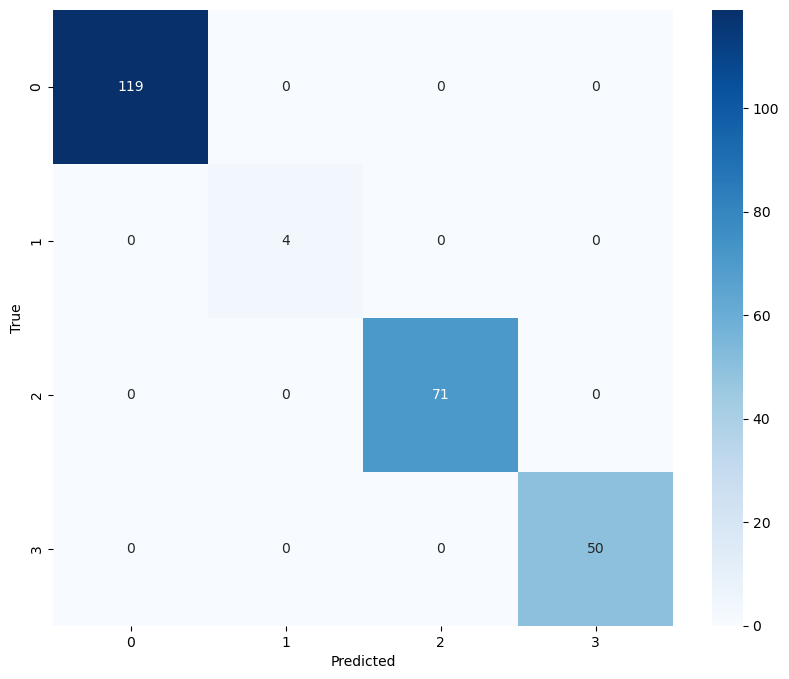

In [223]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Assuming you have y_test and y_pred variables representing the true labels and predicted labels, respectively

# Create confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix using seaborn
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()


In [228]:
print(classification_report(y_test,y_pred))

                                precision    recall  f1-score   support

           Здоровье и медицина       1.00      1.00      1.00       119
Игровая индустрия и киберспорт       1.00      1.00      1.00         4
          Креативные индустрии       1.00      1.00      1.00        71
 Наука, технологии и инновации       1.00      1.00      1.00        50

                      accuracy                           1.00       244
                     macro avg       1.00      1.00      1.00       244
                  weighted avg       1.00      1.00      1.00       244



In [230]:
from sklearn.ensemble import RandomForestClassifier

# Assuming you have already trained a RandomForestClassifier and assigned it to the 'model' variable

# Access the feature importances
importances = model.feature_importances_

# Print the feature importances
for feature_name, importance in zip(x_train.columns, importances):
    print(f"{feature_name}: {importance}")


аббревиатура: 0.0
абзац: 0.0
абитуриент: 0.0
абонент: 0.0
абсолютно: 5.159166457243379e-05
абсолютно весь: 0.0
абсолютно любой: 0.0
абсолютно новый: 0.0
абсолютно нормально: 0.0
абсолютно разный: 0.0
абсолютно уверенный: 4.190437847975726e-05
абсолютный: 0.0
абсолютный большинство: 0.0
абстрагирование: 0.0
абстрагироваться: 0.0
абстрактный: 0.0
абстракция: 0.0
абсурдный: 0.0
аванс: 0.0
авантюра: 0.0
аварийный: 0.0
авария: 0.0
аватар: 0.0
август: 0.0
авиабилет: 0.0
авиакомпания: 0.0
авиационный: 0.0
авиация: 0.0
авить: 0.0
авот: 0.0
австралийский: 0.0
австралия: 0.0
австрия: 0.0
авто: 0.0
автобус: 0.0
автобусный: 0.0
автограф: 0.0
автодополнение: 0.0
автомат: 0.0
автоматизатор: 0.0
автоматизация: 0.0
автоматизация бизнес: 0.0
автоматизация процесс: 0.0
автоматизация работа: 0.0
автоматизация тестирование: 0.0
автоматизированный: 0.0
автоматизированный система: 0.0
автоматизированный тестирование: 0.0
автоматизировать: 0.0
автоматизировать процесс: 0.0
автоматизировать рутинный: 0.0
авто

In [239]:
model.feature_importances_

array([0.        , 0.        , 0.        , ..., 0.00050147, 0.00403878,
       0.00493452])

In [240]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestClassifier

# Assuming you have already trained a RandomForestClassifier and assigned it to the 'model' variable
model = RandomForestClassifier()
model.fit(x_train, y_train)

# Access the feature importances
importances = model.feature_importances_
feature_names = x_train.columns

# Create DataFrame of feature importances
importance_df = pd.DataFrame({'Feature Importance': importances}, index=feature_names)

print(importance_df)


                                              Feature Importance
аббревиатура                                            0.000000
абзац                                                   0.000000
абитуриент                                              0.000000
абонент                                                 0.000000
абсолютно                                               0.000000
...                                                          ...
Nominations_y_Наука, технологии и инновации             0.008146
Nominations_y_Здоровье и медицина                       0.008369
Nominations_y_Игровая индустрия и киберспорт            0.000299
Nominations_y_Креативные индустрии                      0.016165
Nominations_y_Наука, технологии и инновации             0.005763

[31295 rows x 1 columns]


In [247]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import plot_tree




In [248]:
# Assuming you have already trained a RandomForestClassifier and assigned it to the 'model' variable
model = RandomForestClassifier()
model.fit(x_train, y_train)

RandomForestClassifier()

In [249]:
# Select an individual tree from the random forest
tree_index = 0  # Replace with the desired index of the tree

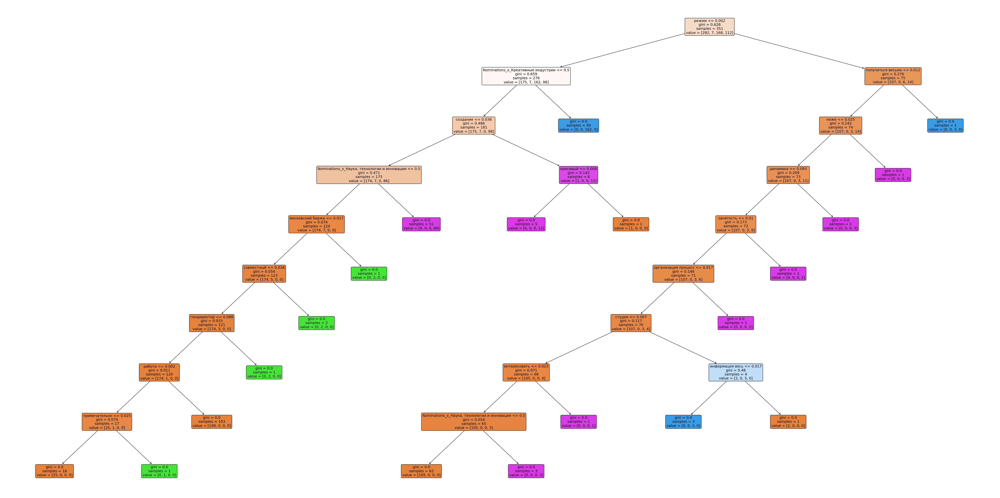

In [258]:
# Visualize the selected tree
plt.figure(figsize=(60, 30),dpi=150)
plot_tree(model.estimators_[tree_index], filled=True, rounded=True, feature_names=x_train.columns)
plt.show()

2.4 Подготовка отчета
Подготовьте отчет о проделанной работе по итогам сессии, в котором будут представлены результаты, выводы и обоснования выбора по каждому разделу задания. Результаты работы должны состоять из отчетов в формате .html и исходников с возможностью перекомпиляции. Архив Data.zip должен содержать все результаты выполнения модуля, а также все необходимые файлы для запуска и проверки участков кода. В файле Readme.txt необходимо описать содержимое результирующих файлов архива Data.zip.



